In [1]:
import nilearn
from nilearn import datasets, plotting
import os
import requests
import csv
import pandas as pd
import nibabel as nib
import numpy as np
from matplotlib import pyplot as plt
import networkx as nx
import scipy
from scipy.stats import multivariate_normal
from scipy.spatial.distance import pdist, squareform
from networkx.drawing.nx_agraph import graphviz_layout

In [2]:
base_dir = '/Users/aj/dmello_lab/fmri_connectivity_trees' # directory where repository lives

# get msdl and whole brain atlases and coords
msdl_data = datasets.fetch_atlas_msdl()
msdl_coords = msdl_data.region_coords

whole_data = datasets.fetch_atlas_harvard_oxford('sub-prob-1mm', data_dir=f'{base_dir}/atlases/HarvardOxford')
whole_coords = plotting.find_probabilistic_atlas_cut_coords(whole_data.maps) # probabilstic map is either 1 or 0

# use deterministic atlas/map
# make sure to resample the image

[get_dataset_dir] Dataset found in /Users/aj/nilearn_data/msdl_atlas
[get_dataset_dir] Dataset found in /Users/aj/dmello_lab/fmri_connectivity_trees/atlases/HarvardOxford/fsl


## 40 subjects functional connectivity

In [3]:
# load 3d shapes
cort_shape = np.loadtxt(f'{base_dir}/code/functional_connectivity/abide/output/roi_time_series/40_MSDL/shape.csv', delimiter=',').astype(int)
 # cereb_shape = np.loadtxt('abide_30_diedrichsen_pooled_3d_shape.csv', delimiter=',').astype(int)
cort_pooled= np.loadtxt(f'{base_dir}/code/functional_connectivity/abide/output/roi_time_series/40_MSDL/pooled.csv', delimiter=',').reshape(cort_shape)

# load and reshape pooled time series
whole_shape = np.loadtxt(f'{base_dir}/code/functional_connectivity/abide/output/roi_time_series/40_HarvardOxford/shape.csv', delimiter=',').astype(int)
# cereb_pooled = np.loadtxt('abide_30_diedrichsen_pooled.csv', delimiter=',').reshape(cereb_shape)
whole_pooled = np.loadtxt(f'{base_dir}/code/functional_connectivity/abide/output/roi_time_series/40_HarvardOxford/pooled.csv', delimiter=',').reshape(whole_shape)

In [4]:
print(cort_pooled.shape)  # check shapes of loaded arrays
print(whole_pooled.shape) # check shapes of loaded arrays

(40, 195, 39)
(40, 195, 21)


In [5]:
# load abide ids
with open(f'{base_dir}/datasets/abide/phenotypic/abide_ids.txt', 'r') as f:
    abide_ids = [line.strip() for line in f.readlines()]

# load mapped phenotypes
with open(f'{base_dir}/datasets/abide/phenotypic/phenotype.txt', 'r') as f:
    phenotype = [int(line.strip()) for line in f.readlines()]

## simple correlation matrices

In [6]:
from nilearn.connectome import ConnectivityMeasure

correlation_measure = ConnectivityMeasure(
    kind="correlation",
    standardize="zscore_sample",
)

In [7]:
# separate timeseries for asd and tdc
def get_groups(pooled_subjects, phenotype):
    asd = []
    tdc = []
    for i in range(len(pooled_subjects)):
        if phenotype[i] == 1:
            asd.append(pooled_subjects[i])
        else: tdc.append(pooled_subjects[i])
    asd = np.array(asd)
    tdc = np.array(tdc)

    return {'asd': asd, 'tdc': tdc}

In [10]:
cort_groups = get_groups(cort_pooled, phenotype)
# cereb_groups = get_groups(cereb_pooled, phenotype)
whole_groups = get_groups(whole_pooled, phenotype)

In [11]:
print(len(cort_groups['asd']), len(cort_groups['tdc'])) # check number of subjects in each group

20 20


In [99]:
# calculate mean correlation matrix and mean corr arr
def get_mean_corr(pooled_subjects: dict, correlation_measure=correlation_measure):

    asd = pooled_subjects['asd']
    tdc = pooled_subjects['tdc']

    correlation_asd = correlation_measure.fit_transform(asd)
    mean_correlation_matrix_asd = correlation_measure.mean_

    correlation_tdc = correlation_measure.fit_transform(tdc)
    mean_correlation_matrix_tdc = correlation_measure.mean_

    mean_corr_asd = np.mean(mean_correlation_matrix_asd, axis=1)
    mean_corr_tdc = np.mean(mean_correlation_matrix_tdc, axis=1)
    
    # dictionary containing tuple with mean correlation matrix and mean correlation
    return {'asd': (correlation_asd, mean_correlation_matrix_asd, mean_corr_asd), 'tdc': (correlation_tdc, mean_correlation_matrix_tdc, mean_corr_tdc)}

In [100]:
#visualize asd and tdc corr side by side
def visualize_corr(asd_mat, tdc_mat):

    # Set the figure size and create subplots
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))  # Wider figure for better readability

    # Set consistent color scale across both plots
    vmin = min(asd_mat.min(), tdc_mat.min())
    vmax = max(asd_mat.max(), tdc_mat.max())

    # Plot the first matrix
    im1 = axes[0].matshow(asd_mat, vmin=vmin, vmax=vmax, cmap='viridis')
    axes[0].set_title('ASD Cort')

    # Plot the second matrix
    axes[1].matshow(tdc_mat, vmin=vmin, vmax=vmax, cmap='viridis')
    axes[1].set_title('TDC Cort')

    # Add a shared colorbar without overlap
    cbar = fig.colorbar(im1, ax=axes.ravel().tolist(), orientation='vertical', fraction=0.05, pad=0.05)
    cbar.ax.set_position([1, 0.15, 0.02, 0.7])  # [x, y, width, height]

    # Improve layout spacing
    plt.subplots_adjust(wspace=0.3, right=0.9)

    # Adjust layout
    plt.tight_layout()
    plt.show()

In [101]:
# get cort corr matrices
mean_corr_cort = get_mean_corr(cort_groups)

# get cereb corr matrices
# mean_corr_cereb = get_mean_corr(cereb_groups)  

# get whole corr matrices
mean_corr_whole = get_mean_corr(whole_groups)

In [102]:
#visualize asd and tdc corr side by side
def visualize_corr(mean_corr, title='Correlation Matrices'):

    asd_mat = mean_corr['asd'][1]  # mean correlation matrix for ASD
    tdc_mat = mean_corr['tdc'][1]  # mean correlation matrix for TDC

    # Set the figure size and create subplots
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))  # Wider figure for better readability

    # Set consistent color scale across both plots
    vmin = min(asd_mat.min(), tdc_mat.min())
    vmax = max(asd_mat.max(), tdc_mat.max())

    # Plot the first matrix
    im1 = axes[0].matshow(asd_mat, vmin=vmin, vmax=vmax, cmap='viridis')
    axes[0].set_title('ASD')

    # Plot the second matrix
    im2 = axes[1].matshow(tdc_mat, vmin=vmin, vmax=vmax, cmap='viridis')
    axes[1].set_title('TDC')

    # Add a shared colorbar without overlap
    cbar = fig.colorbar(im1, ax=axes.ravel().tolist(), orientation='vertical', fraction=0.05, pad=0.05)
    cbar.ax.set_position([1, 0.15, 0.02, 0.7])  # [x, y, width, height]

    # Improve layout spacing
    plt.subplots_adjust(wspace=0.3, right=0.9)

    # Adjust layout
    plt.tight_layout()
    plt.show()

/var/folders/lg/kgxc1tq55372n0km3vwpwdtm0000gn/T/ipykernel_75313/979966279.py:30: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


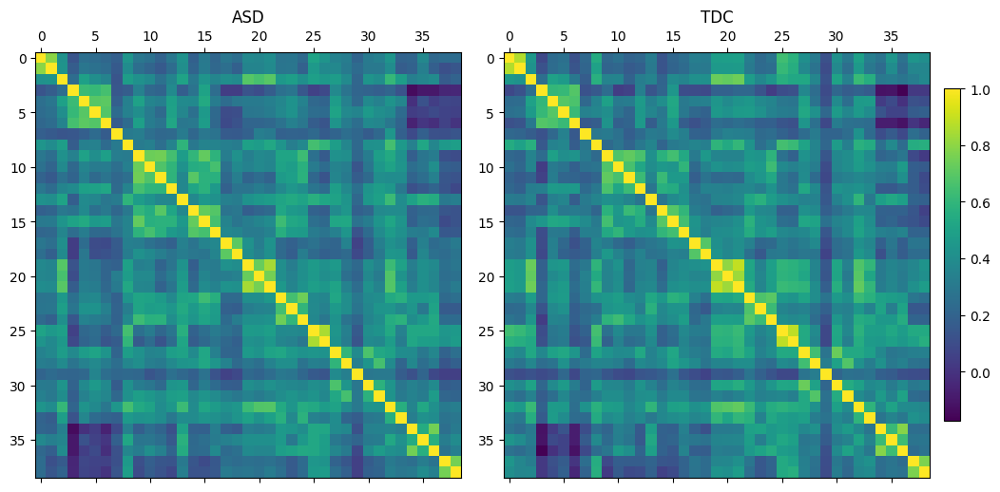

In [103]:
visualize_corr(mean_corr_cort) # visualize cort mean correlation matrices

/var/folders/lg/kgxc1tq55372n0km3vwpwdtm0000gn/T/ipykernel_75313/979966279.py:30: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


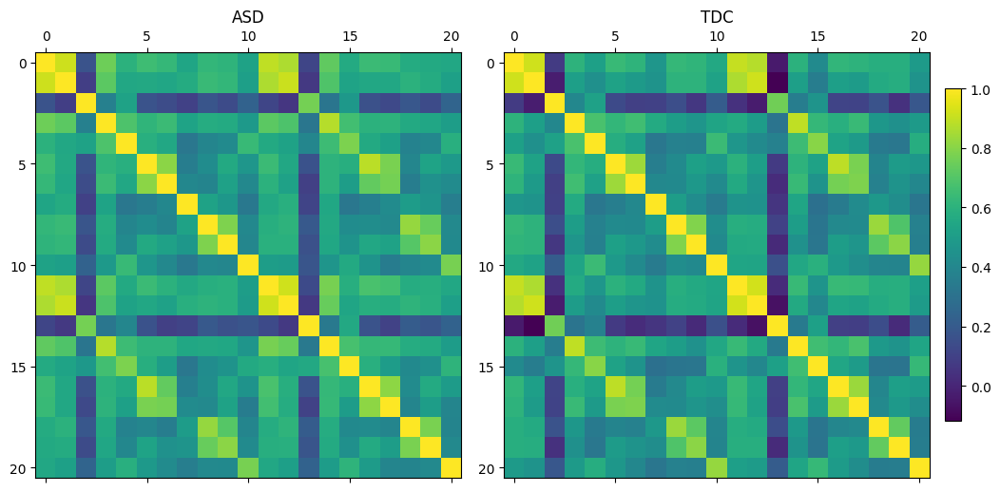

In [104]:
visualize_corr(mean_corr_whole, title='Whole brain') # visualize whole mean correlation matrices

In [105]:
def plot_connectome(mean_correlation_matrix, coords, title='connectome', edge_threshold="70%"):
    """
    Plot the connectome using the mean correlation matrix and coordinates.
    """
    # Plotting the connectome
    plotting.plot_connectome(
        mean_correlation_matrix,
        coords,
        title=title,
        edge_threshold=edge_threshold,  # Only plot edges above the 90th percentile
        colorbar=True,
        node_size=10,
    )
    plt.show()

In [106]:
def view_connectome(mean_correlation_matrix, coords, edge_threshold="70%"):
    """
    view the connectome using the mean correlation matrix and coordinates.
    """
    view = plotting.view_connectome(mean_correlation_matrix, coords, edge_threshold=edge_threshold) # Use nilearn's view_connectome to view in browser
    return view

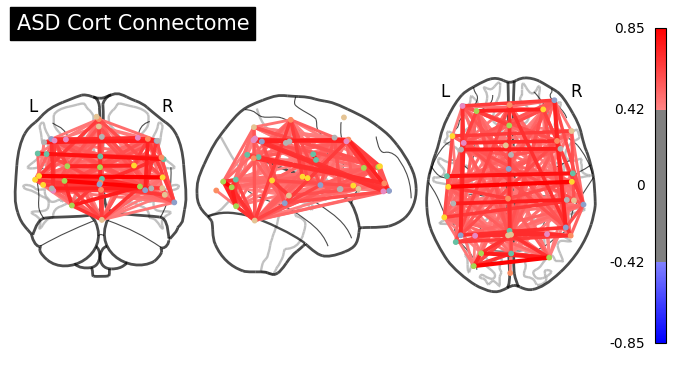

In [107]:
plot_connectome(
    mean_corr_cort['asd'][1],  # Mean correlation matrix for ASD
    msdl_coords,  # Coordinates for MSDL atlas
    title = "ASD Cort Connectome"
)


In [108]:
view_connectome(
    mean_corr_cort['asd'][1],  # Mean correlation matrix for ASD
    msdl_coords,  # Coordinates for MSDL atlas
)

/Users/aj/miniconda3/envs/dynamric/lib/python3.13/site-packages/nilearn/plotting/html_document.py:103: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  warnings.warn(


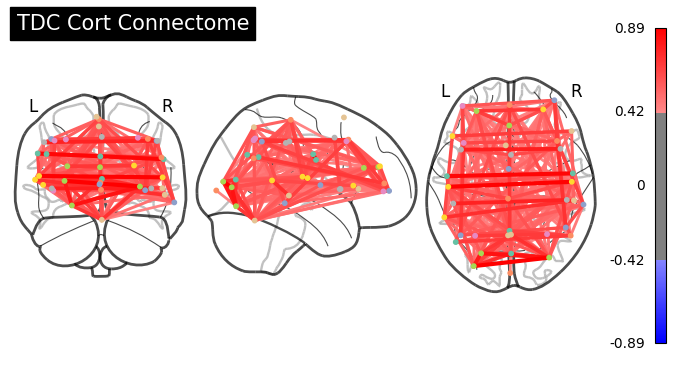

In [109]:
plot_connectome(
    mean_corr_cort['tdc'][1],  # Mean correlation matrix for TDC
    msdl_coords,  # Coordinates for MSDL atlas
    title = "TDC Cort Connectome"
)

In [110]:
view_connectome(
    mean_corr_cort['tdc'][1],  # Mean correlation matrix for ASD
    msdl_coords,  # Coordinates for MSDL atlas
)

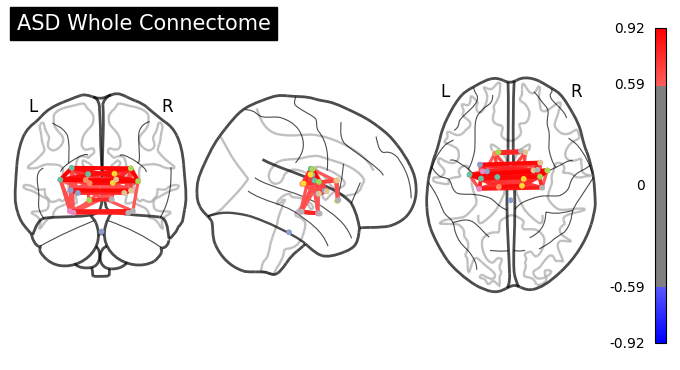

In [111]:
plot_connectome(
    mean_corr_whole['asd'][1],  # Mean correlation matrix for ASD
    whole_coords,  # Coordinates for Harvard-Oxford atlas
    "ASD Whole Connectome"
)

In [112]:
view_connectome(
    mean_corr_whole['asd'][1],  # Mean correlation matrix for ASD
    whole_coords,  # Coordinates for Harvard-Oxford atlas
    edge_threshold="70%" # Use this to limit edges to the top x% of connections by weight
)

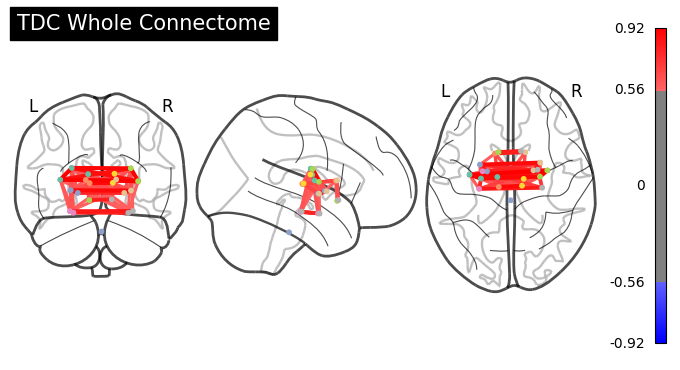

In [113]:
plot_connectome(
    mean_corr_whole['tdc'][1],  # Mean correlation matrix for TDC
    whole_coords,  # Coordinates for Harvard-Oxford atlas
    "TDC Whole Connectome"
)

In [114]:
view_connectome(
    mean_corr_whole['tdc'][1],  # Mean correlation matrix for TDC
    whole_coords,  # Coordinates for Harvard-Oxford atlas
)

## partial correlation

In [115]:
partial_correlation_measure = ConnectivityMeasure(
    kind="partial correlation",
    standardize="zscore_sample",
)

In [116]:
# get cort corr matrices
mean_partial_cort = get_mean_corr(cort_groups, correlation_measure=partial_correlation_measure)

# get cereb corr matrices
# mean_corr_cereb = get_mean_corr(cereb_groups)  

# get whole corr matrices
mean_partial_whole = get_mean_corr(whole_groups, correlation_measure=partial_correlation_measure)

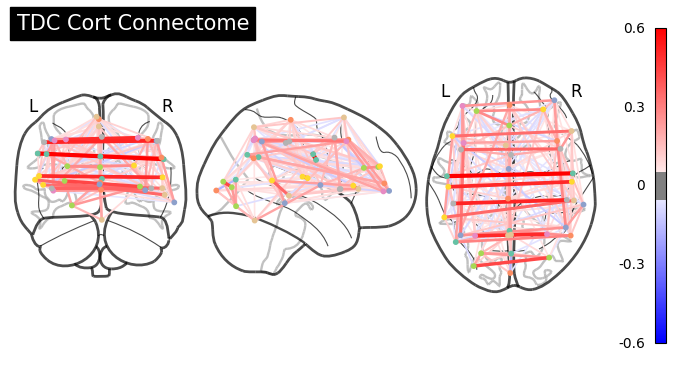

In [117]:
plot_connectome(
    mean_partial_cort['tdc'][1],  # Mean correlation matrix for TDC
    msdl_coords,  # Coordinates for MSDL atlas
    title = "TDC Cort Connectome"
)

In [118]:
view_connectome(
    mean_partial_cort['tdc'][1],  # Mean correlation matrix for TDC
    msdl_coords,  # Coordinates for MSDL atlas
)

/Users/aj/miniconda3/envs/dynamric/lib/python3.13/site-packages/nilearn/plotting/html_document.py:103: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  warnings.warn(


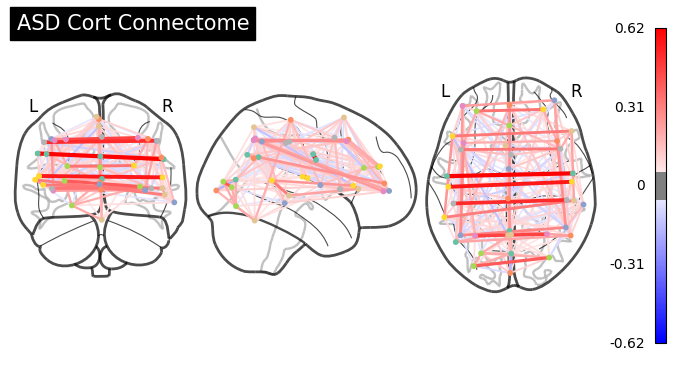

In [119]:
plot_connectome(
    mean_partial_cort['asd'][1],  # Mean correlation matrix for TDC
    msdl_coords,  # Coordinates for MSDL atlas
    title = "ASD Cort Connectome"
)

In [120]:
view_connectome(
    mean_partial_cort['asd'][1],  # Mean correlation matrix for TDC
    msdl_coords,  # Coordinates for MSDL atlas
)

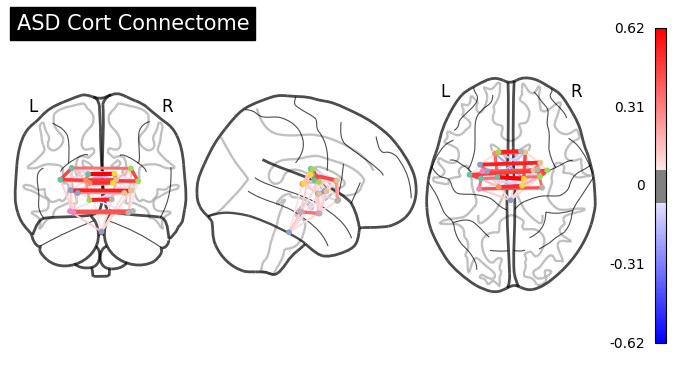

In [121]:
plot_connectome(
    mean_partial_whole['asd'][1],  # Mean correlation matrix for TDC
    whole_coords,  # Coordinates for MSDL atlas
    title = "ASD Cort Connectome"
)

In [122]:
view_connectome(
    mean_partial_whole['asd'][1],  # Mean correlation matrix for TDC
    whole_coords,  # Coordinates for HarvardOxford atlas
)

## tangent measure

In [123]:
tangent_measure = ConnectivityMeasure(
    kind="tangent",
    standardize="zscore_sample",
)

In [124]:
# get cort corr matrices
mean_tangent_cort = get_mean_corr(cort_groups, correlation_measure=partial_correlation_measure)

# get cereb corr matrices
# mean_corr_cereb = get_mean_corr(cereb_groups)  

# get whole corr matrices
mean_tangent_whole = get_mean_corr(whole_groups, correlation_measure=partial_correlation_measure)

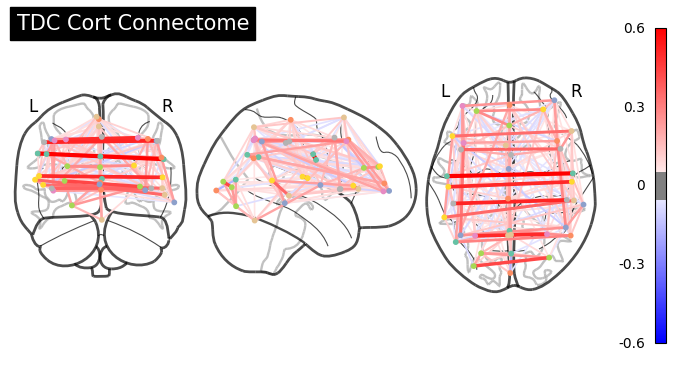

In [125]:
plot_connectome(
    mean_tangent_cort['tdc'][1],  # Mean correlation matrix for TDC
    msdl_coords,  # Coordinates for MSDL atlas
    title = "TDC Cort Connectome"
)

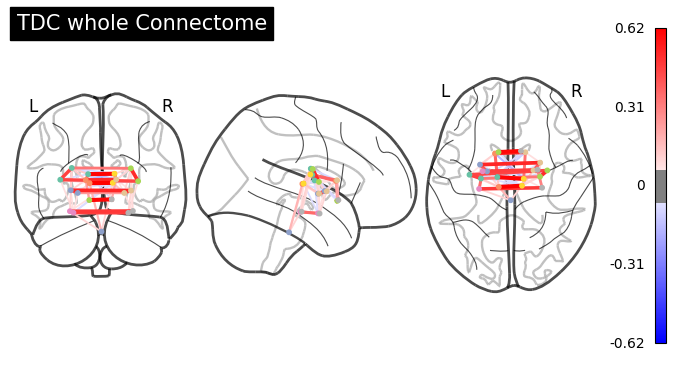

In [126]:
plot_connectome(
    mean_tangent_whole['tdc'][1],  # Mean correlation matrix for TDC
    whole_coords,  # Coordinates for MSDL atlas
    title = "TDC whole Connectome"
)

In [127]:
view_connectome(
    mean_tangent_cort['tdc'][1],  # Mean correlation matrix for TDC
    msdl_coords,  # Coordinates for MSDL atlas
)

/Users/aj/miniconda3/envs/dynamric/lib/python3.13/site-packages/nilearn/plotting/html_document.py:103: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  warnings.warn(


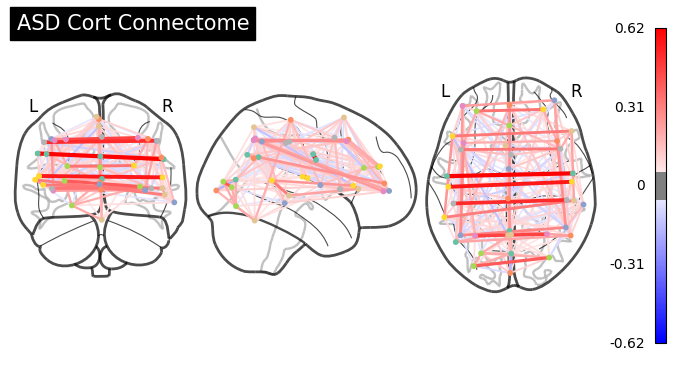

In [128]:
plot_connectome(
    mean_tangent_cort['asd'][1],  # Mean correlation matrix for TDC
    msdl_coords,  # Coordinates for MSDL atlas
    title = "ASD Cort Connectome"
)

In [129]:
view_connectome(
    mean_tangent_cort['asd'][1],  # Mean correlation matrix for TDC
    msdl_coords,  # Coordinates for MSDL atlas
)

## Calculate covariance matrices from time series

In [130]:
cort_groups['asd'].shape # check shape of the first group (ASD) pooled time series

(20, 195, 39)

In [131]:
cort_groups['tdc'].shape # check shape of the first subject's time series in the ASD group

(20, 195, 39)

In [137]:
def covariance_crunch_participants(pooled_subjects):

    mean_cort = np.mean(pooled_subjects, axis=0) # mean of the pooled subjects in the ASD group
    # Compute covariance matrices for the pooled subjects in the ASD group

    print(f'crunched matrix: {mean_cort.shape}') # check shape of the mean correlation matrix

    # covariance of ROIs
    R = mean_cort.T @ mean_cort / (mean_cort.shape[0] - 1) # Compute covariance matrix, using the formula R = X'X/(n-1)
    print(f'roi cov: {R.shape}')

    # covariance of time binds
    T = mean_cort @ mean_cort.T / (mean_cort.shape[0] - 1) # Compute covariance matrix, using the formula R = X'X/(n-1)
    print(f'time cov: {T.shape}')

    return R, T


def covariance_matrices(pooled_subjects, group='all', crunch_dim='participants'):

    if crunch_dim == 'participants':

        if group=='all':
            all_subjects = np.concatenate((pooled_subjects['asd'], pooled_subjects['tdc']), axis=0) # concatenate all pooled subjects from both groups
            print(f'subject matrix: {all_subjects.shape}')
            cov_matrices = covariance_crunch_participants(all_subjects)
        else:
            print(f'subject matrix: {pooled_subjects[group].shape}')
            cov_matrices = covariance_crunch_participants(pooled_subjects[group])
    
    return cov_matrices


In [138]:
R, T = covariance_matrices(cort_groups)

subject matrix: (40, 195, 39)
crunched matrix: (195, 39)
roi cov: (39, 39)
time cov: (195, 195)


In [147]:
#visualize asd and tdc corr side by side
def visualize_covariance_matrices(R, T):

    fig, axes = plt.subplots(1, 2, figsize=(20, 10))

    # Plot covariance of ROIs
    im1 = axes[0].matshow(R, cmap='viridis')
    axes[0].set_title('Covariance of ROIs')
    plt.colorbar(im1, ax=axes[0])

    # Plot covariance of time binds
    im2 = axes[1].matshow(T, cmap='viridis')
    axes[1].set_title('Covariance of Time Bins')
    plt.colorbar(im2, ax=axes[1])

    plt.tight_layout()
    plt.show()

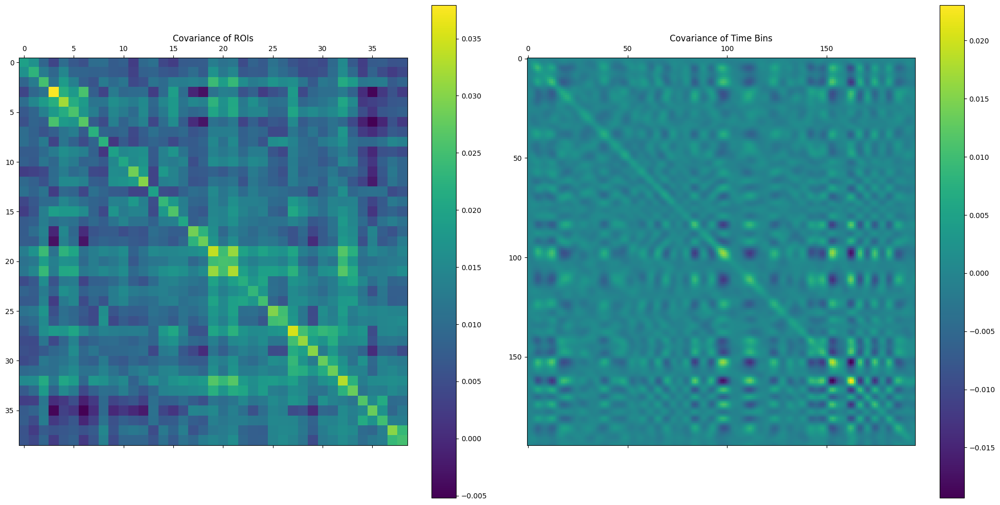

In [148]:
visualize_covariance_matrices(R, T)

## calculate mutual information and chow-liu tree

In [155]:
def chow_liu_tree(cov_matrix):
    """
    Constructs the Chow-Liu tree given a covariance matrix.
    Args:
        cov_matrix (np.ndarray): Covariance matrix (n x n)
    Returns:
        G (nx.Graph): Chow-Liu tree as a NetworkX graph
    """
    n = cov_matrix.shape[0]

    # Convert covariance matrix to mutual information matrix
    mi_matrix = np.zeros((n, n))

    for i in range(n):
        for j in range(n):
            if i != j:
                # Compute joint and marginal entropy
                var_i = cov_matrix[i, i]
                var_j = cov_matrix[j, j]
                joint_var = np.linalg.det(cov_matrix[np.ix_([i, j], [i, j])])

                # Mutual information formula for Gaussian variables
                mi_matrix[i, j] = 0.5 * np.log(var_i * var_j / joint_var)

    # Convert mutual information to distance (negative to use minimum spanning tree)
    dist_matrix = -mi_matrix

    # Build MST using NetworkX
    G = nx.Graph()
    for i in range(n):
        for j in range(i + 1, n):
            G.add_edge(i, j, weight=dist_matrix[i, j])

    mst = nx.minimum_spanning_tree(G, weight='weight')
    
    return mst

def plot_chow_liu_network(tree, labels=None):
    """
    Plots the Chow-Liu tree using NetworkX.
    """
    pos = nx.spring_layout(tree)
    plt.figure(figsize=(10, 7))
    nx.draw(tree, pos, with_labels=True, labels=labels, node_size=700, node_color='skyblue', font_size=12, font_weight='bold')
    
    edge_labels = nx.get_edge_attributes(tree, 'weight')
    edge_labels = {k: f"{-v:.2f}" for k, v in edge_labels.items()}  # Flip sign for display

    nx.draw_networkx_edge_labels(tree, pos, edge_labels=edge_labels)
    plt.title("Chow-Liu Tree Visualization")
    plt.show()

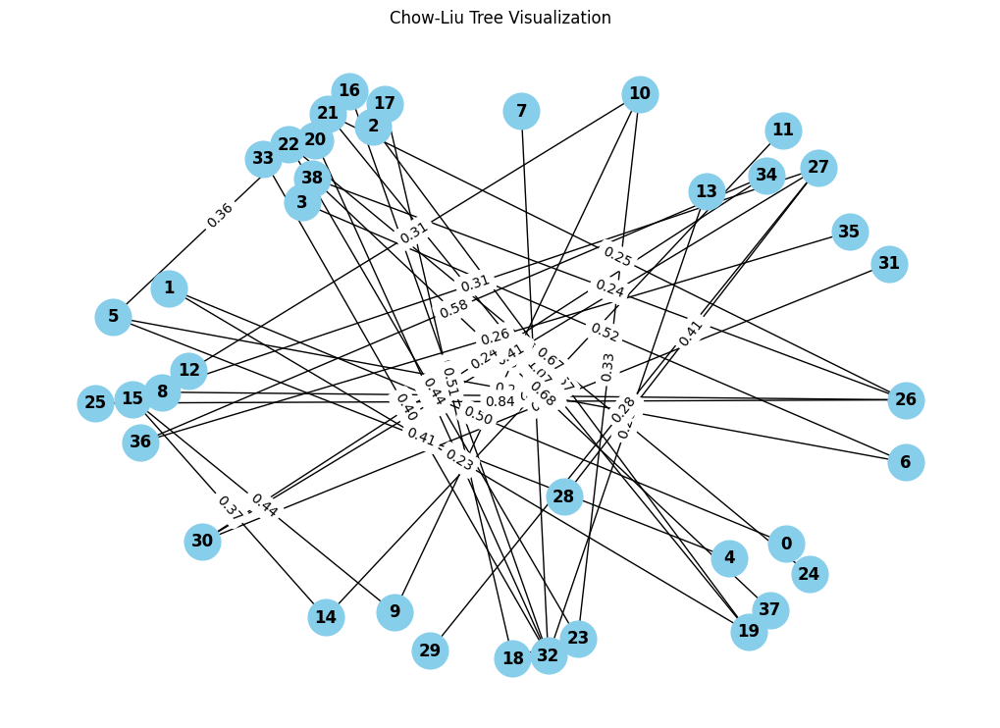

In [156]:
R_mst = chow_liu_tree(R) # get chow-liu tree from covariance of ROIs
# Plot the Chow-Liu tree for covariance of ROIs
plot_chow_liu_network(R_mst)

In [158]:
def threshold_tree(tree, threshold=0.4):
    """
    Removes edges from the tree below the threshold value.
    Args:
        tree (nx.Graph): Chow-Liu tree.
        threshold (float): Minimum mutual information to keep an edge.
    Returns:
        nx.Graph: Thresholded tree.
    """
    # Create a copy of the tree to avoid modifying the original
    sparse_tree = tree.copy()

    # Remove edges below the threshold
    for u, v, data in list(sparse_tree.edges(data=True)):
        if -data['weight'] < threshold:  # Flip sign back to positive for MI
            sparse_tree.remove_edge(u, v)

    return sparse_tree

def plot_thresholded_tree(tree, labels=None, title="Thresholded Chow-Liu Tree"):
    """
    Plots the thresholded tree using NetworkX.
    """
    pos = nx.spring_layout(tree)
    plt.figure(figsize=(10, 7))
    
    # Draw nodes and edges
    nx.draw(tree, pos, with_labels=True, labels=labels, node_size=700, node_color='lightgreen', font_size=12, font_weight='bold')
    
    # Draw edge labels with mutual information values
    edge_labels = nx.get_edge_attributes(tree, 'weight')
    edge_labels = {k: f"{-v:.2f}" for k, v in edge_labels.items()}  # Flip back sign for display

    nx.draw_networkx_edge_labels(tree, pos, edge_labels=edge_labels)
    plt.title(title)
    plt.show()


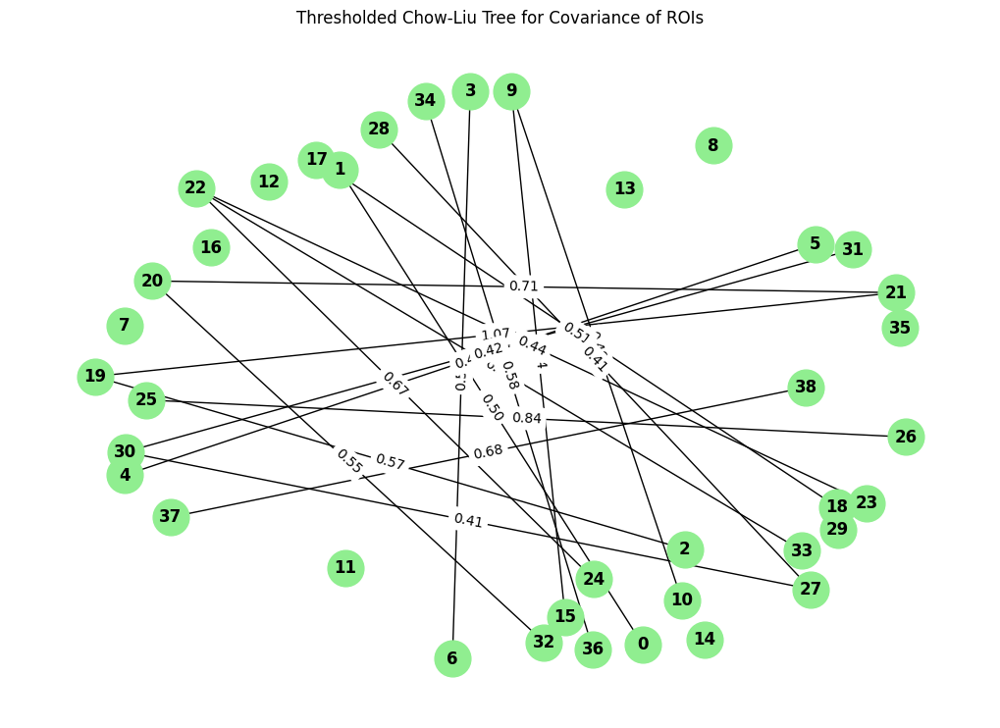

In [159]:
plot_thresholded_tree(threshold_tree(R_mst, threshold=0.4), 
    title="Thresholded Chow-Liu Tree for Covariance of ROIs") # Plot the thresholded tree

In [194]:
def hierarchical_layout(tree, root=0, layer_gap=1.5, width=10):
    """
    Creates a hierarchical layout for a tree component.
    Args:
        tree (nx.Graph): A connected component of the tree.
        root (int): Root node for layout.
        layer_gap (float): Vertical distance between layers.
        width (float): Horizontal spacing of the tree.
    Returns:
        dict: Positions for nodes.
    """
    levels = {root: 0}
    pos = {root: (0, 0)}
    
    def dfs(node, x=0, y=0, depth=0, spacing=width):
        """Recursive DFS to position nodes."""
        children = list(tree.neighbors(node))
        children = [c for c in children if c not in levels]

        if not children:
            return

        dx = spacing / max(1, len(children))
        next_x = x - (spacing / 2)

        for i, child in enumerate(children):
            levels[child] = depth + 1
            next_x += dx
            pos[child] = (next_x, y - layer_gap)
            dfs(child, next_x, y - layer_gap, depth + 1, spacing / 2)

    dfs(root)
    return pos


def plot_hierarchical_tree_with_components(tree, labels=None, title="Hierarchical Chow-Liu Tree"):
    """
    Plots a hierarchical tree layout, handling disconnected components.
    """
    plt.figure(figsize=(12, 8))

    # Identify connected components
    components = list(nx.connected_components(tree))

    # Layout for each component
    spacing = 15  # Horizontal spacing between components
    x_offset = 0  # Starting x position for the first component

    for component in components:
        subgraph = tree.subgraph(component)
        
        # Find a root node (first node in the component)
        root = list(component)[0]

        # Generate hierarchical layout for the component
        component_pos = hierarchical_layout(subgraph, root=root, width=10)

        # Offset component to avoid overlap
        component_pos = {node: (x + x_offset, y) for node, (x, y) in component_pos.items()}
        x_offset += spacing  # Add space for the next component

        # Draw the component
        nx.draw(subgraph, component_pos, with_labels=True, labels=labels, node_size=400, 
                node_color='skyblue', font_size=10, font_weight='bold', edge_color='gray')

        # Add edge labels
        edge_labels = nx.get_edge_attributes(subgraph, 'weight')
        edge_labels = {k: f"{-v:.2f}" for k, v in edge_labels.items()}  # Flip sign back for display
        # nx.draw_networkx_edge_labels(subgraph, component_pos, edge_labels=edge_labels, font_size=10)

    plt.title(title)
    plt.show()



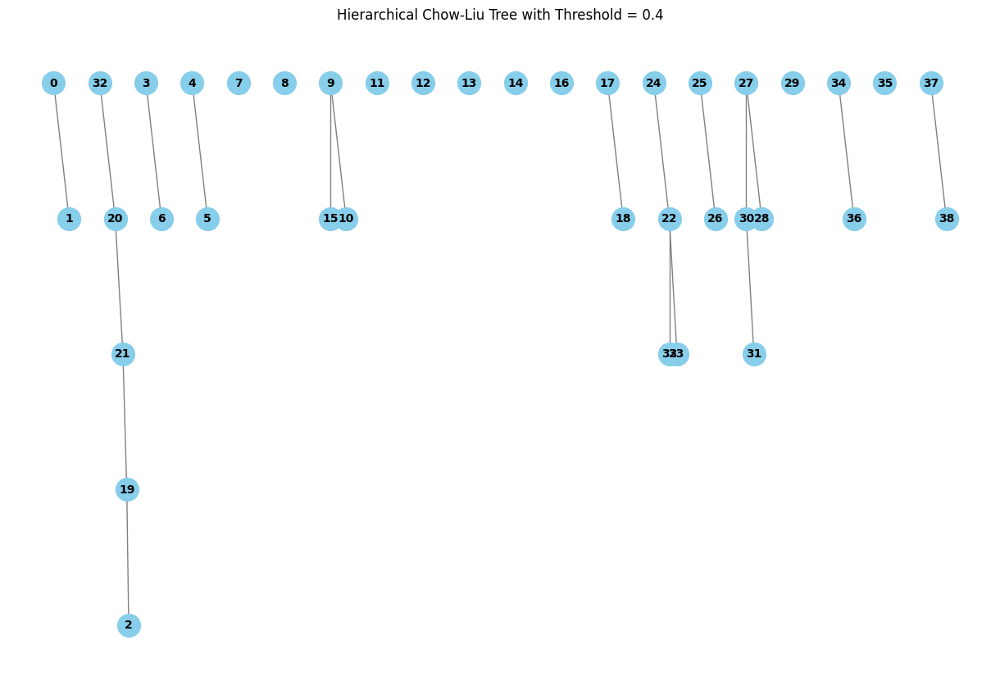

In [196]:
# Generate the Chow-Liu tree
tree = chow_liu_tree(R)  # Use the covariance matrix R to generate the Chow-Liu tree

# Apply thresholding
threshold = 0.4
sparse_tree = threshold_tree(tree, threshold)

# Visualize the hierarchical tree with multiple components
plot_hierarchical_tree_with_components(sparse_tree, title=f"Hierarchical Chow-Liu Tree with Threshold = {threshold}")

subject matrix: (20, 195, 39)
crunched matrix: (195, 39)
roi cov: (39, 39)
time cov: (195, 195)


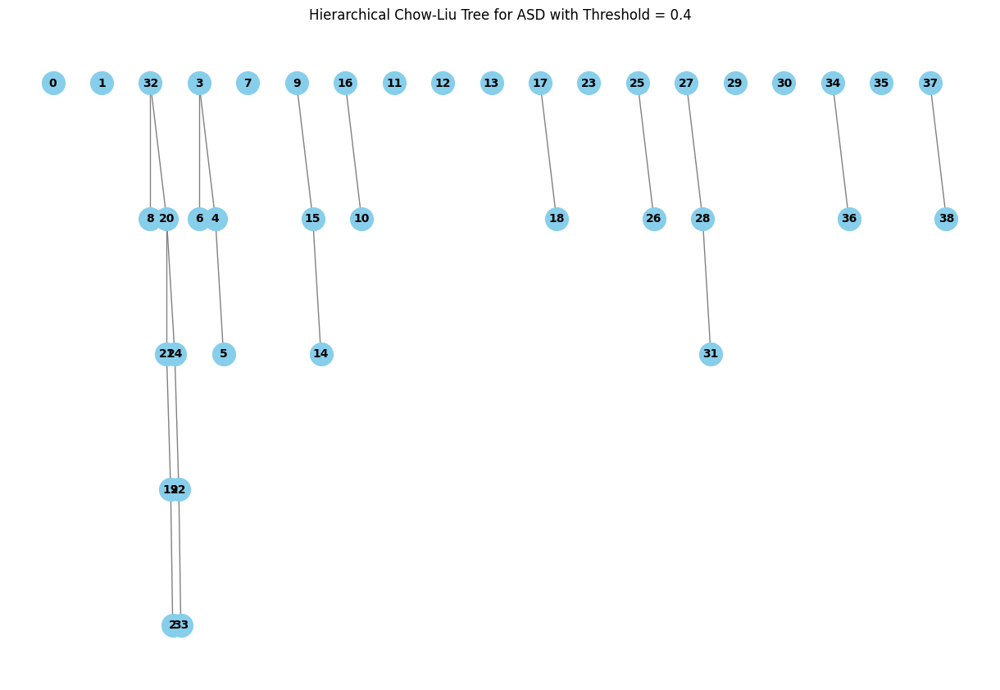

subject matrix: (20, 195, 39)
crunched matrix: (195, 39)
roi cov: (39, 39)
time cov: (195, 195)


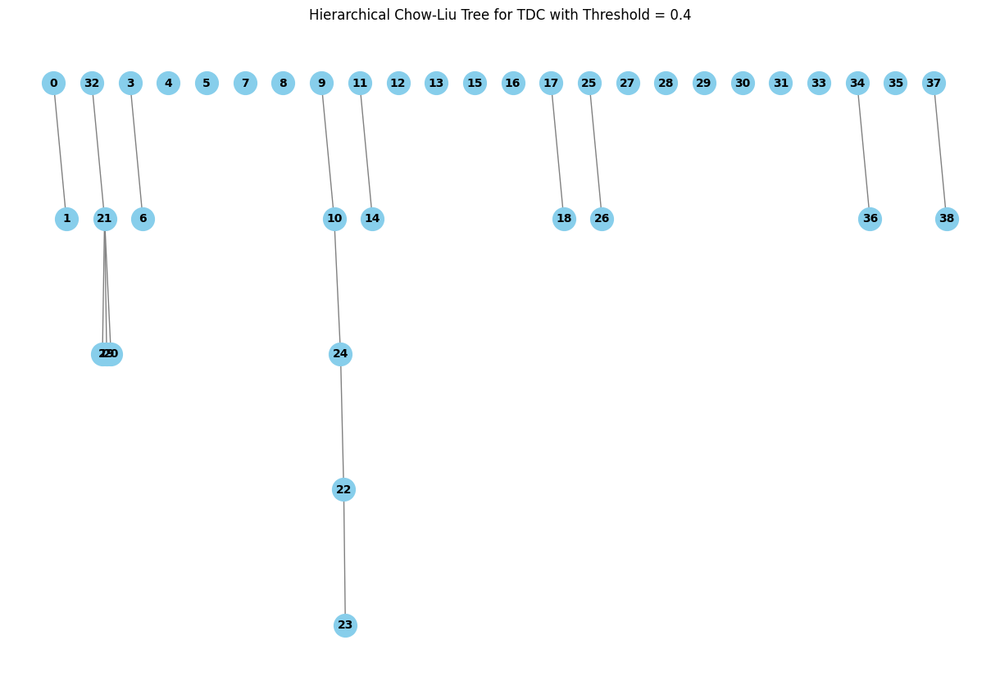

In [197]:
# asd tree
# Generate the Chow-Liu tree for the ASD group
R, T = covariance_matrices(cort_groups, group='asd')
tree_asd = chow_liu_tree(R)  # Use the covariance matrix R to generate the Chow-Liu tree for ASD
# Apply thresholding for the ASD tree
sparse_tree_asd = threshold_tree(tree_asd, threshold=0.4)
# Visualize the hierarchical tree for the ASD group
plot_hierarchical_tree_with_components(
    sparse_tree_asd, 
    title=f"Hierarchical Chow-Liu Tree for ASD with Threshold = 0.4"
)
# tdc tree
# Generate the Chow-Liu tree for the TDC group
R, T = covariance_matrices(cort_groups, group='tdc')
tree_tdc = chow_liu_tree(R)  # Use the covariance matrix R to generate the Chow-Liu tree for TDC
# Apply thresholding for the TDC tree
sparse_tree_tdc = threshold_tree(tree_tdc, threshold=0.4)
# Visualize the hierarchical tree for the TDC group
plot_hierarchical_tree_with_components(
    sparse_tree_tdc, 
    title=f"Hierarchical Chow-Liu Tree for TDC with Threshold = 0.4"
)
